# 8章 テキストから画像生成モデルの創造的応用


## 事前準備

In [ ]:
!curl -L -o genaibook.zip https://github.com/oreilly-japan/hands-on-generative-ai-ja/releases/download/genaibook/genaibook.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100  4678  100  4678    0     0   6029      0 --:--:-- --:--:-- --:--:--  6029


In [ ]:
!unzip genaibook.zip

Archive:  genaibook.zip
Made with MacWinZipper (http://tidajapan.com/macwinzipper)
  inflating: genaibook/__init__.py   
  inflating: genaibook/core.py       


In [ ]:
!pip install evaluate jiwer

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.1/84.1 kB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 139.7 MB/s eta 0:00:00


In [ ]:
!pip install datasets==4.2.0

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 506.3/506.3 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.7/47.7 MB 41.0 MB/s eta 0:00:00
  Attempting uninstall: pyarrow
    Found existing installation: pyarrow 18.1.0
    Uninstalling pyarrow-18.1.0:
      Successfully uninstalled pyarrow-18.1.0
  Attempting uninstall: datasets
    Found existing installation: datasets 2.14.4
    Uninstalling datasets-2.14.4:
      Successfully uninstalled datasets-2.14.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 25.2.1 requires pyarrow<20.0.0a0,>=14.0.0; platform_machine == "x86_64", but you have pyarrow 22.0.0 which is incompatible.
pylibcudf-cu12 25.2.1 requires pyarrow<20.0.0a0,>=14.0.0; platform_machine == "x86_64", but you have pyarrow 22.0.0 which is incompatible.


In [ ]:
!pip install --no-deps trl==0.23.1 bitsandbytes==0.48.1 compel==2.1.1

  Using cached compel-2.1.1-py3-none-any.whl.metadata (13 kB)
Using cached compel-2.1.1-py3-none-any.whl (31 kB)


In [ ]:
from huggingface_hub import login
login()

## 画像から画像

In [ ]:
import torch
from diffusers import StableDiffusionXLImg2ImgPipeline

from genaibook.core import get_device

device = get_device()

# パイプラインを読み込む
img2img_pipeline = StableDiffusionXLImg2ImgPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-refiner-1.0",
    torch_dtype=torch.float16,
    variant="fp16",
)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

text_encoder_2/model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

unet/diffusion_pytorch_model.fp16.safete(…):   0%|          | 0.00/4.52G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.fp16.safeten(…):   0%|          | 0.00/167M [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.fp16.saf(…):   0%|          | 0.00/167M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

In [ ]:
# パイプラインをデバイスに移動させる
# あるいは img2img_pipeline.enable_model_cpu_offload() を使用する
img2img_pipeline.to(device)

StableDiffusionXLImg2ImgPipeline {
  "_class_name": "StableDiffusionXLImg2ImgPipeline",
  "_diffusers_version": "0.34.0",
  "_name_or_path": "stabilityai/stable-diffusion-xl-refiner-1.0",
  "feature_extractor": [
    null,
    null
  ],
  "force_zeros_for_empty_prompt": false,
  "image_encoder": [
    null,
    null
  ],
  "requires_aesthetics_score": true,
  "scheduler": [
    "diffusers",
    "EulerDiscreteScheduler"
  ],
  "text_encoder": [
    null,
    null
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    null,
    null
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

  0%|          | 0/35 [00:00<?, ?it/s]

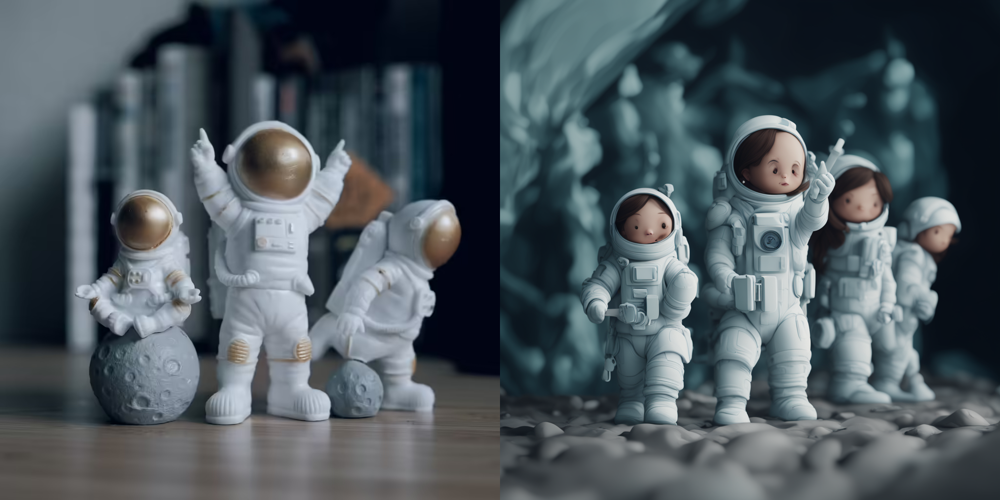

In [ ]:
from genaibook.core import image_grid, load_image, SampleURL

# 画像を読み込む
url = SampleURL.ToyAstronauts
init_image = load_image(url)
generator = torch.Generator(device=device).manual_seed(1)

prompt = "Astronauts in a jungle, cold color palette, muted colors, detailed, 8k"

# プロンプトと画像をパイプラインに渡す
image = img2img_pipeline(prompt, image=init_image, generator=generator, strength=0.7).images[0]
image_grid([init_image, image], rows=1, cols=2)

In [ ]:
del img2img_pipeline
torch.cuda.empty_cache()

## インペインティング

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

text_encoder/model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

text_encoder_2/model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.fp16.safete(…):   0%|          | 0.00/5.14G [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.fp16.saf(…):   0%|          | 0.00/167M [00:00<?, ?B/s]

vae/diffusion_pytorch_model.fp16.safeten(…):   0%|          | 0.00/167M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

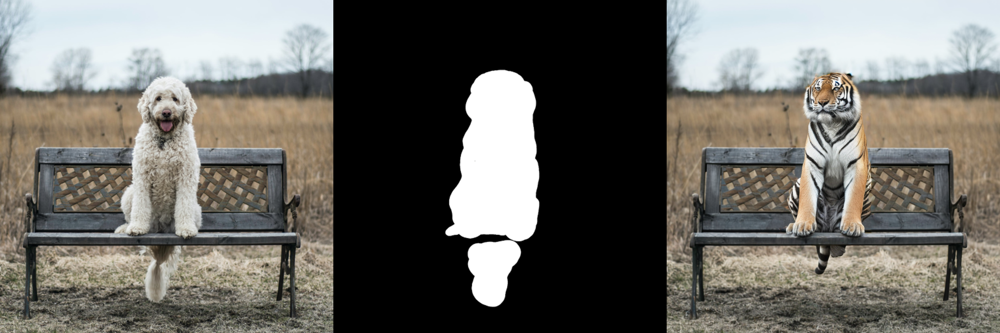

In [ ]:
from diffusers import StableDiffusionXLInpaintPipeline

# パイプラインを読み込む
inpaint_pipeline = StableDiffusionXLInpaintPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16,
    variant="fp16",
).to(device)

img_url = SampleURL.DogBenchImage
mask_url = SampleURL.DogBenchMask

init_image = load_image(img_url, size=(1024, 1024))
mask_image = load_image(mask_url, size=(1024, 1024))

# プロンプトと画像をパイプラインに渡す
prompt = "A majestic tiger sitting on a bench"
image = inpaint_pipeline(
    prompt=prompt,
    image=init_image,
    mask_image=mask_image,
    num_inference_steps=50,
    strength=0.80,
    width=init_image.size[0],
    heigth=init_image.size[1],
).images[0]

image_grid([init_image, mask_image, image], rows=1, cols=3)

In [ ]:
del inpaint_pipeline
torch.cuda.empty_cache()

## プロンプト重み付けと画像編集

### プロンプト重み付けとマージ

In [ ]:
from diffusers import DiffusionPipeline

pipeline = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16,
    variant="fp16",
).to(device)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
from compel import Compel, ReturnedEmbeddingsType

# CLIPモデルでもっとも表現力が高いとされる最終層から2番目の層を使用する。
embeddings_type = (
    ReturnedEmbeddingsType.PENULTIMATE_HIDDEN_STATES_NON_NORMALIZED
)
compel = Compel(
    tokenizer=[pipeline.tokenizer, pipeline.tokenizer_2],
    text_encoder=[pipeline.text_encoder, pipeline.text_encoder_2],
    returned_embeddings_type=embeddings_type,
    requires_pooled=[False, True],
)

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

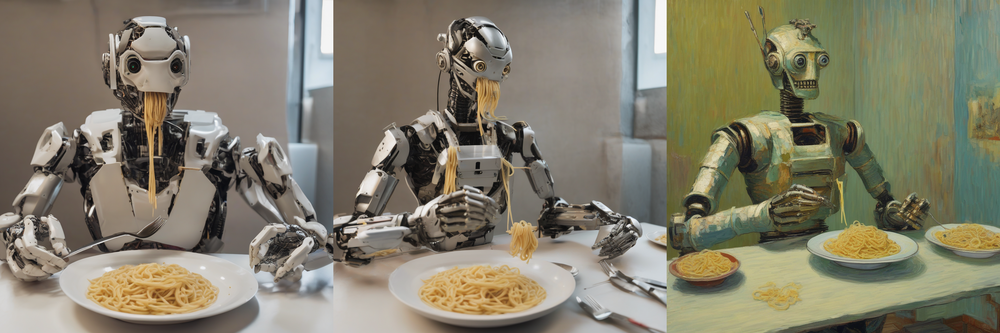

In [ ]:
from diffusers.utils import make_image_grid

# プロンプトの準備
prompts = []
prompts.append("a humanoid robot eating pasta")
prompts.append(
    "a humanoid+++ robot eating pasta"
)  # 人型ロボットの特徴を少し強調する
prompts.append(
    '["a humanoid robot eating pasta", "a van gogh painting"].and(0.8, 0.2)'
)  # ゴッホ風にする

images = []
for prompt in prompts:
    # すべての生成で同じシード値を使用する
    generator = torch.Generator(device=device).manual_seed(1)

    # compelライブラリは、条件付けのベクトルと
    # プーリングプロンプトの埋め込みの両方を返す
    conditioning, pooled = compel(prompt)

    # 条件とプーリングプロンプトの埋め込みをパイプラインに渡す
    image = pipeline(
        prompt_embeds=conditioning,
        pooled_prompt_embeds=pooled,
        num_inference_steps=30,
        generator=generator,
    ).images[0]
    images.append(image)
image_grid(images, rows=1, cols=3)

In [ ]:
del pipeline
del conditioning
del pooled
del compel
torch.cuda.empty_cache()

#### Semantic Guidanceによる拡散画像の編集

In [ ]:
from diffusers import SemanticStableDiffusionPipeline

semantic_pipeline = SemanticStableDiffusionPipeline.from_pretrained(
    "CompVis/stable-diffusion-v1-4", torch_dtype=torch.float16, variant="fp16"
).to(device)

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

text_encoder/model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

safety_checker/model.fp16.safetensors:   0%|          | 0.00/608M [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

scheduler_config-checkpoint.json:   0%|          | 0.00/209 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

unet/diffusion_pytorch_model.fp16.safete(…):   0%|          | 0.00/1.72G [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.fp16.safeten(…):   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The SemanticStableDiffusionPipeline has been deprecated and will not receive bug fixes or feature updates after Diffusers version 0.33.1. 


In [ ]:
seed = 7667

  0%|          | 0/51 [00:00<?, ?it/s]

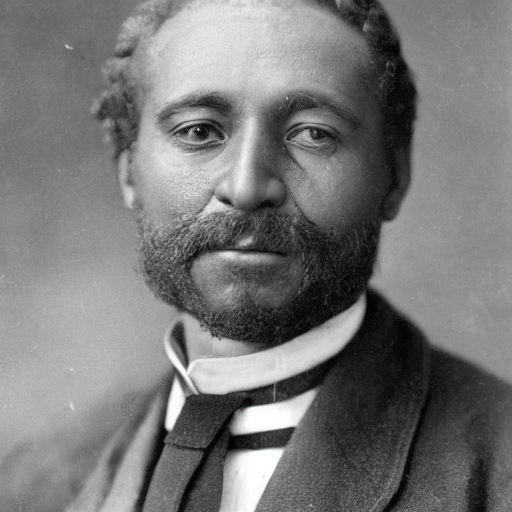

In [ ]:
generator = torch.Generator(device=device).manual_seed(seed)
out = semantic_pipeline(
    prompt="a photo of the face of a man",
    negative_prompt="low quality, deformed",
    generator=generator,
)
out.images[0]

  0%|          | 0/51 [00:00<?, ?it/s]

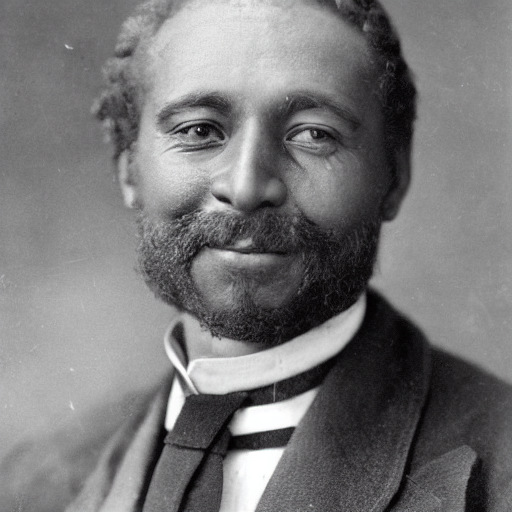

In [ ]:
generator = torch.Generator(device=device).manual_seed(seed)
out = semantic_pipeline(
    prompt="a photo of the face of a man",
    negative_prompt="low quality, deformed",
    editing_prompt="smiling, smile",
    edit_guidance_scale=4,
    edit_warmup_steps=10,
    edit_threshold=0.99,
    edit_momentum_scale=0.3,
    edit_mom_beta=0.6,
    reverse_editing_direction=False,
    generator=generator,
)
out.images[0]

  0%|          | 0/51 [00:00<?, ?it/s]

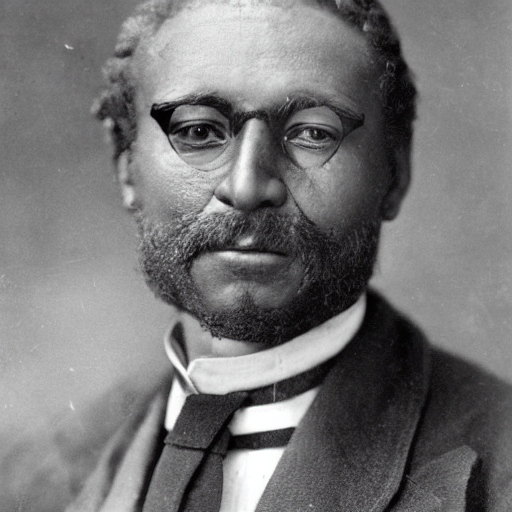

In [ ]:
generator = torch.Generator(device=device).manual_seed(seed)
out = semantic_pipeline(
    prompt="a photo of the face of a man",
    negative_prompt="low quality, deformed",
    editing_prompt="glasses, wearing glasses",
    reverse_editing_direction=False,
    edit_warmup_steps=10,
    edit_guidance_scale=4,
    edit_threshold=0.99,
    edit_momentum_scale=0.3,
    edit_mom_beta=0.6,
    generator=generator,
)
out.images[0]

  0%|          | 0/51 [00:00<?, ?it/s]

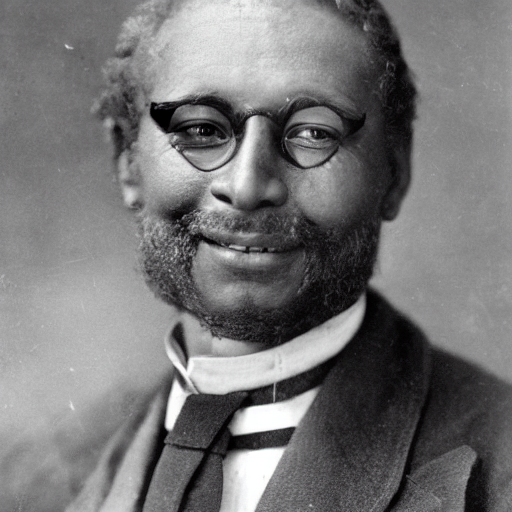

In [ ]:
generator = torch.Generator(device=device).manual_seed(seed)
out = semantic_pipeline(
    prompt="a photo of the face of a man",
    negative_prompt="low quality, deformed",
    editing_prompt=[
        "smiling, smile",
        "glasses, wearing glasses",
    ],
    reverse_editing_direction=[False, False],
    edit_warmup_steps=[10, 10],
    edit_guidance_scale=[6, 6],
    edit_threshold=[0.99, 0.99],
    edit_momentum_scale=0.3,
    edit_mom_beta=0.6,
    generator=generator,
)
out.images[0]

In [ ]:
del semantic_pipeline
torch.cuda.empty_cache()

## インバージョンによる実画像編集

### LEDITS++による編集

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

text_encoder/model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

safety_checker/model.fp16.safetensors:   0%|          | 0.00/608M [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.fp16.safeten(…):   0%|          | 0.00/167M [00:00<?, ?B/s]

unet/diffusion_pytorch_model.fp16.safete(…):   0%|          | 0.00/1.72G [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

This pipeline only supports DDIMScheduler and DPMSolverMultistepScheduler. The scheduler has been changed to DPMSolverMultistepScheduler.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

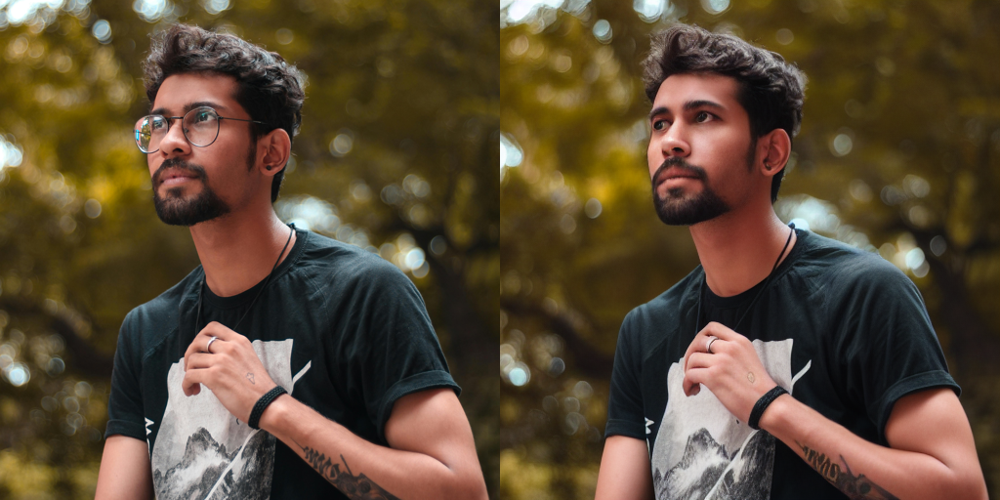

In [ ]:
from diffusers import LEditsPPPipelineStableDiffusion

# 通常通りモデルを読み込む
pipe = LEditsPPPipelineStableDiffusion.from_pretrained(
    "stable-diffusion-v1-5/stable-diffusion-v1-5",
    torch_dtype=torch.float16,
    variant="fp16"
)
pipe.to(device)

image = load_image(SampleURL.ManInGlasses)

# 画像をインバートする
# 画像に徐々にノイズを追加し、編集方向にノイズ除去することで、
# 実質的に編集を実現する
pipe.invert(image=image, num_inversion_steps=50, skip=0.2)

# 編集用プロンプトで画像を編集する
edited_image = pipe(
    editing_prompt=["glasses"],
    # モデルに編集方向を指示し、メガネを取り除くよう促す
    reverse_editing_direction=[True],
    edit_guidance_scale=[1.5],
    edit_threshold=[0.95],
).images[0]

image_grid([image, edited_image], rows=1, cols=2)

In [ ]:
del pipe
torch.cuda.empty_cache()

### インストラクションファインチューニングによる実画像編集

実行前に https://huggingface.co/stabilityai/cosxl にてライセンス条項の確認および利用に関する同意が必要

cosxl_edit.safetensors:   0%|          | 0.00/6.94G [00:00<?, ?B/s]

Fetching 17 files:   0%|          | 0/17 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/607 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

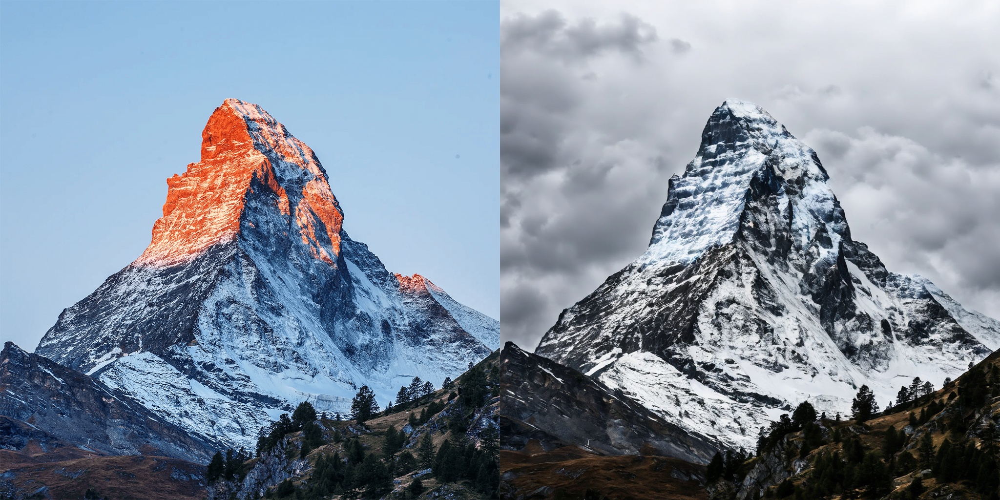

In [ ]:
from diffusers import (
    EDMEulerScheduler,
    StableDiffusionXLInstructPix2PixPipeline,
)
from huggingface_hub import hf_hub_download

edit_file = hf_hub_download(
    repo_id="stabilityai/cosxl", filename="cosxl_edit.safetensors"
)

# from_single_fileにより、単一のdiffusersファイルから拡散モデルを読み込む
pipe_edit = StableDiffusionXLInstructPix2PixPipeline.from_single_file(
    edit_file, num_in_channels=8, is_cosxl_edit=True, torch_dtype=torch.float16
)

# このモデルはEDMEulerSchedulerがノイズ除去に最適な
# ノイズスケジューラーとなるように訓練されている
pipe_edit.scheduler = EDMEulerScheduler(
    sigma_min=0.002,
    sigma_max=120.0,
    sigma_data=1.0,
    prediction_type="v_prediction",
    sigma_schedule="exponential",
)
pipe_edit.to(device)

prompt = "make it a cloudy day"
image = load_image(SampleURL.Mountain)
edited_image = pipe_edit(
    prompt=prompt, image=image, num_inference_steps=20
).images[0]

image_grid([image, edited_image], rows=1, cols=2)

In [ ]:
del pipe_edit
torch.cuda.empty_cache()

## ControlNet

In [ ]:
from diffusers import ControlNetModel, StableDiffusionXLControlNetPipeline

controlnet = ControlNetModel.from_pretrained(
    "diffusers/controlnet-depth-sdxl-1.0",
    torch_dtype=torch.float16,
    variant="fp16",
)

controlnet_pipeline = StableDiffusionXLControlNetPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    controlnet=controlnet,
    torch_dtype=torch.float16,
    variant="fp16",
)
# controlnet_pipeline.enable_model_cpu_offload()  # オプション。VRAMを節約する場合
controlnet_pipeline = controlnet_pipeline.to(device)

config.json: 0.00B [00:00, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/2.50G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
!pip install --no-deps controlnet_aux==0.0.10

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 290.4/290.4 kB 31.1 MB/s eta 0:00:00


In [ ]:
from controlnet_aux import MidasDetector
from PIL import Image

original_image = load_image(SampleURL.WomanSpeaking, size=(1024, 1024))

# MiDASの深度推定モデルを読み込む
midas = MidasDetector.from_pretrained("lllyasviel/Annotators")

# MiDASの深度推定を適用する
processed_image_midas = midas(original_image).resize(
    (1024, 1024), Image.BICUBIC
)

/usr/local/lib/python3.11/dist-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)
/usr/local/lib/python3.11/dist-packages/timm/models/registry.py:4: FutureWarning: Importing from timm.models.registry is deprecated, please import via timm.models
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.models", FutureWarning)
/usr/local/lib/python3.11/dist-packages/controlnet_aux/segment_anything/modeling/tiny_vit_sam.py:654: UserWarning: Overwriting tiny_vit_5m_224 in registry with controlnet_aux.segmen

dpt_hybrid-midas-501f0c75.pt:   0%|          | 0.00/493M [00:00<?, ?B/s]

/usr/local/lib/python3.11/dist-packages/timm/models/_factory.py:138: UserWarning: Mapping deprecated model name vit_base_resnet50_384 to current vit_base_r50_s16_384.orig_in21k_ft_in1k.
  model = create_fn(


  0%|          | 0/30 [00:00<?, ?it/s]

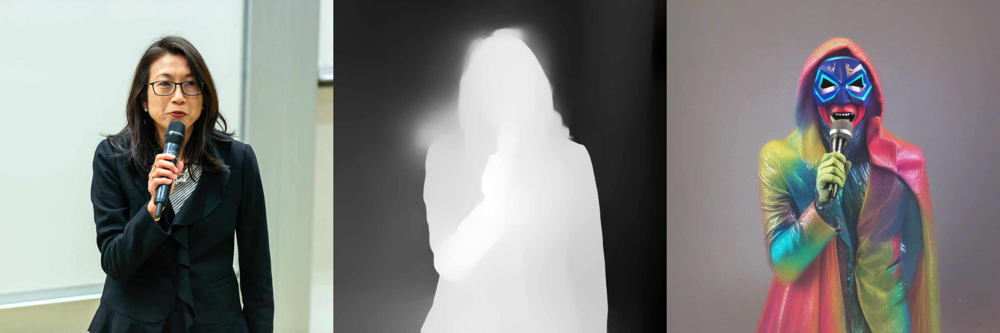

In [ ]:
image = controlnet_pipeline(
    "A colorful, ultra-realistic masked super hero singing a song",
    image=processed_image_midas,
    controlnet_conditioning_scale=0.4,
    num_inference_steps=30,
).images[0]
image_grid([original_image, processed_image_midas, image], rows=1, cols=3)

In [ ]:
del controlnet
del controlnet_pipeline
torch.cuda.empty_cache()

## 画像プロンプティングと画像バリエーション

### 画像バリエーション

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

sdxl_models/ip-adapter_sdxl.bin:   0%|          | 0.00/703M [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

sdxl_models/image_encoder/model.safetens(…):   0%|          | 0.00/3.69G [00:00<?, ?B/s]

  0%|          | 0/25 [00:00<?, ?it/s]

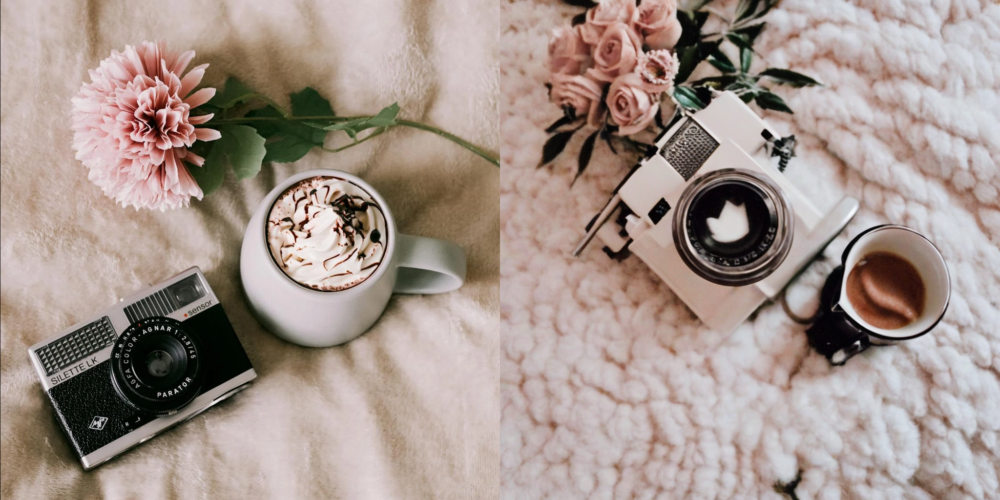

In [ ]:
from diffusers import StableDiffusionXLPipeline

sdxl_base_pipeline = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16,
    variant="fp16",
)
sdxl_base_pipeline.to(device)

# IP-Adapterも読み込む
sdxl_base_pipeline.load_ip_adapter(
    "h94/IP-Adapter", subfolder="sdxl_models", weight_name="ip-adapter_sdxl.bin"
)

# IP-Adapterが結果全体にどの程度の影響を与えるか、
# そのスケールを設定する
sdxl_base_pipeline.set_ip_adapter_scale(0.8)

image = load_image(SampleURL.ItemsVariation)
original_image = image.resize((1024, 1024))

# 画像バリエーションの生成
generator = torch.Generator(device=device).manual_seed(1)
variation_image = sdxl_base_pipeline(
    prompt="",
    ip_adapter_image=original_image,
    num_inference_steps=25,
    generator=generator,
).images

image_grid([original_image, variation_image[0]], rows=1, cols=2)

In [ ]:
del sdxl_base_pipeline
torch.cuda.empty_cache()

### 画像プロンプティング

#### スタイル転送

In [ ]:
# 先ほどと同じように、モデルとIP-Adapterを読み込む
pipeline = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16
).to(device)

# モデルにIP-Adapterを読み込む
pipeline.load_ip_adapter(
    "h94/IP-Adapter", subfolder="sdxl_models", weight_name="ip-adapter_sdxl.bin"
)

# SDXLでスタイルに関連する中間層のみに
# IP-Adapterを適用する
scale = {"up": {"block_0": [0.0, 1.0, 0.0]}}
pipeline.set_ip_adapter_scale(scale)

image = load_image(SampleURL.Mamoeiro)
original_image = image.resize((1024, 1024))

# 推論を実行してスタイルを適用した画像を生成する
generator = torch.Generator(device=device).manual_seed(0)
variation_image = pipeline(
    prompt="a cat inside of a box",
    ip_adapter_image=original_image,
    num_inference_steps=25,
    generator=generator,
).images

image_grid([original_image, variation_image[0]], rows=1, cols=2)

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.safetens(…):   0%|          | 0.00/335M [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
del pipeline
torch.cuda.empty_cache()

#### 追加の制御


diffusion_pytorch_model.safetensors:   0%|          | 0.00/5.00G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

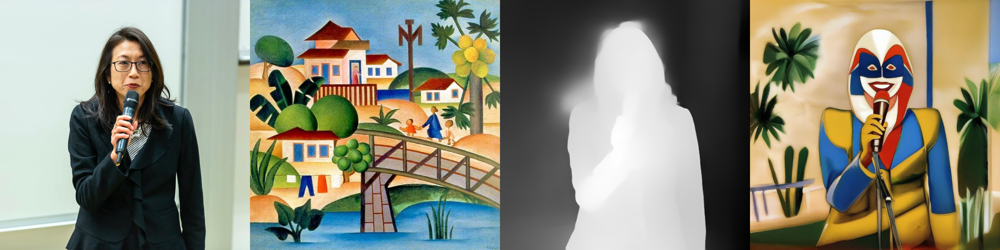

In [ ]:
controlnet = ControlNetModel.from_pretrained(
    "diffusers/controlnet-depth-sdxl-1.0", torch_dtype=torch.float16
)

# ControlNetパイプラインを読み込む
controlnet_pipeline = StableDiffusionXLControlNetPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    controlnet=controlnet,
    torch_dtype=torch.float16,
    variant="fp16",
)
controlnet_pipeline.to(device)

# IP-Adapterを読み込む
controlnet_pipeline.load_ip_adapter(
    "h94/IP-Adapter", subfolder="sdxl_models", weight_name="ip-adapter_sdxl.bin"
)
# SDXLでスタイルに関連する中間層のみに
# IP-Adapterを適用する
scale = {
    "up": {"block_0": [0.0, 1.0, 0.0]},
}
controlnet_pipeline.set_ip_adapter_scale(scale)

# 元画像を読み込む
original_image = load_image(SampleURL.WomanSpeaking)
original_image = original_image.resize((1024, 1024))

# スタイル画像を読み込む
style_image = load_image(SampleURL.Mamoeiro)
style_image = style_image.resize((1024, 1024))

# MiDAS深度推定を適用する
processed_image_midas = midas(original_image).resize(
    (1024, 1024), Image.BICUBIC
)

image = controlnet_pipeline(
    "A masked super hero singing a song",
    image=processed_image_midas,
    ip_adapter_image=style_image,
    controlnet_conditioning_scale=0.5,
).images[0]
image_grid(
    [original_image, style_image, processed_image_midas, image], rows=1, cols=4
)

In [ ]:
del controlnet
del controlnet_pipeline
torch.cuda.empty_cache()

## 解答


### 演習

**1. インペインティングと、画像から画像（image-to-image）の変換との違いを説明し、実用的な応用例を挙げよ。**

インペインティングと画像から画像（image-to-image）変換の違いは、インペインティングが画像内の特定のマスクされた領域のみを補完、置換するのに対し、画像から画像の変換は画像全体を変換する点にある。インペインティングの実用例としては、写真から不要な人物を取り除くといった用途が挙げられる。一方、画像から画像の例としては、昼間の風景を夜の風景に変換することが挙げられる。


**2. プロンプト重み付けは拡散モデルの限界をどのように拡げるか。**

プロンプト重み付けは、プロンプト解釈に対してきめ細かいコントロールを与えることで、拡散モデルの制約を克服する。プロンプト内の各要素に異なる重みを割り当てることで、最終画像における特定要素の強調や抑制が可能になる。これは、モデルが特定の解釈に偏りやすい場合や、プロンプトの特定部分により注意を向けたい場合に有効である。たとえば、「森の中の赤い車」という画像を生成したいが、モデルが森にばかり注目してしまう場合、「赤い車」の重みを上げることで、狙った画像をより正確に得ることができる。このようなきめ細かい制御は、モデルのデフォルトの挙動が意図通りの結果を出さない場合にも有効である。


**3. Prompt-to-Prompt編集とSEGAの主な違いは何か。**

Prompt-to-Prompt：
* 元画像の構造や全体の構図を保ちながら、入力プロンプトの微調整によって生成画像を編集する手法。
* クロスアテンション層を直接変更し、テキスト埋め込みを活用して編集の工程を誘導する。

SEGA：
* 生成過程において、特定の意味的（セマンティック）概念を強調または抑制することで誘導を行う手法。
* 潜在空間のガイダンス信号を調整し、生成時に意味的特徴を優先する。


**4. ControlNetは拡散モデルの能力をどのように強化するか説明せよ。また、ControlNetで使用できる条件の例を挙げよ。**

ControlNetは、様々なタイプの入力条件を使って画像生成プロセスに追加の制御を加えることで、拡散モデルの能力を高める。これは追加の条件を解釈してメインの拡散モデルを誘導する独立したニューラルネットワークを訓練する形で実現する。これにより、テキストプロンプトだけでは困難だった、はるかに精密な生成画像の制御が可能となる。

a. エッジマップやスケッチ：特定の輪郭や構造に従った画像を生成できる。

b. ポーズ推定データ：特定のポーズを取る人物や動物の画像を生成するよう誘導できる。

c. 深度マップ：特定の3D構造や遠近感を持つ画像を生成できる。

d. セグメンテーションマップ：生成画像のレイアウトや構成を制御できる。

e. 法線マップ：表面ディテールや質感を持たせた画像生成を誘導できる。


**5. テキストから画像を生成するモデルの文脈における「インバージョン」とは何か。何が実現できるか。**

実画像をモデルの潜在空間にマッピングし直す処理を指す。このプロセスでは、実画像をノイズに「逆変換」し、潜在空間に写像することで、元画像の完全な再構成や編集を可能にする。
